### Importing the Libraries

In [1]:
import os
import glob
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from matplotlib import patches
import matplotlib.patheffects as pe
from astropy.io import fits
from astropy.nddata import Cutout2D
from photutils.profiles import RadialProfile

from photutils.background import Background2D, SExtractorBackground
from astropy.stats import biweight_location, mad_std, sigma_clipped_stats, SigmaClip
from scipy.ndimage import binary_dilation
from photutils.segmentation import detect_threshold, detect_sources

source_extractor = '/usr/local/bin/sex'
print('libraries imported')

libraries imported


### Handling the FITS

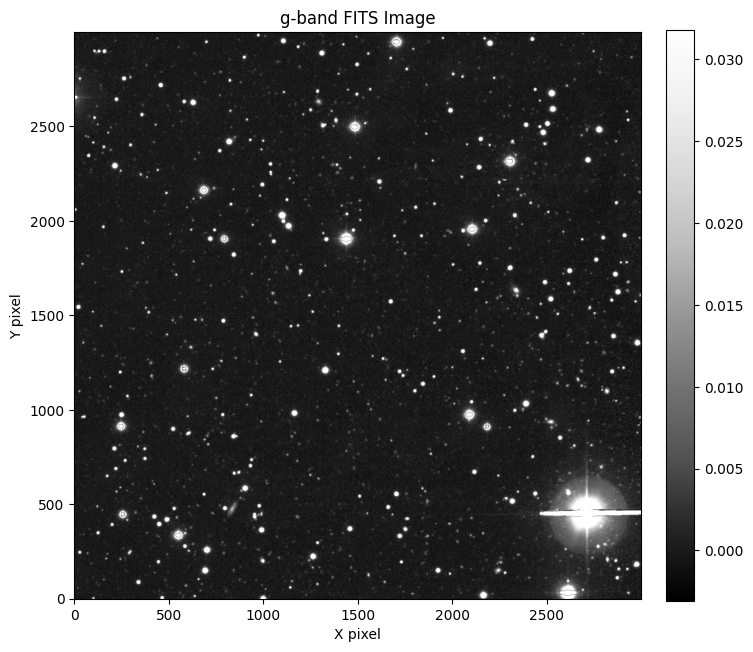

SIMPLE  =                    T / file does conform to FITS standard             BITPIX  =                  -32 / number of bits per data pixel                  NAXIS   =                    2 / number of data axes                            NAXIS1  =                 3000 / length of data axis 1                          NAXIS2  =                 3000 / length of data axis 2                          EXTEND  =                    T / FITS dataset may contain extensions            COMMENT   FITS (Flexible Image Transport System) format is defined in 'AstronomyCOMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H SURVEY  = 'DECaLS  '                                                            VERSION = 'DR9-north'                                                           IMAGETYP= 'IMAGE   '           / None                                           BANDS   = 'g       '                                                            BAND0   = 'g       '                    

In [2]:
fits_path = '/home/raditraian1107/PSF_development/FITS_images/cutout_251.0256_36.4566.fits'

with fits.open(fits_path) as hdul:
    header = hdul[0].header  
    data = hdul[0].data

plt.figure(figsize=(8,8))
im = plt.imshow(data, origin='lower', cmap='Greys_r',
                vmin=np.percentile(data, 1),
                vmax=np.percentile(data, 99))
plt.title('g-band FITS Image')
plt.xlabel('X pixel')
plt.ylabel('Y pixel')
plt.colorbar(im, fraction=0.046, pad=0.04)
plt.show()

print(header)

for key, value in header.items():
    print(f"{key}: {value}")

In [3]:
pixscale = 0.262

fitspath = '/home/raditraian1107/PSF_development/FITS_images/'
fits_pathlist = sorted(glob.glob(fitspath+'*.fits'))
fits_list = sorted([os.path.basename(f) for f in glob.glob(fitspath+'*.fits')])

seinpath = os.path.join(fitspath, 'se_in_out/')
seoutpath = seinpath

out_param_path = os.path.join(seinpath, 'default.param')
conv_filter = '/usr/local/share/sextractor/gauss_3.0_5x5.conv'

In [4]:
nnw_path = "/home/raditraian1107/PSF_development/FITS_images/se_in_out/default.nnw"
psf_path = "/home/raditraian1107/PSF_development/FITS_images/se_in_out/default.psf"

for i, filename in enumerate(fits_list, start=1):
    image_dir = fits_pathlist[i-1]
    base_name = filename.replace('.fits', '')
    cat_out_name = os.path.join(seoutpath, f'outparams_{base_name}.cat')

    template_path = os.path.join(seinpath, f'{base_name}.SEtemplate')
    with open(template_path, 'w') as text:
        text.write(f"""CATALOG_NAME     {cat_out_name}
CATALOG_TYPE     ASCII_HEAD
PARAMETERS_NAME  {out_param_path}

DETECT_TYPE      CCD
DETECT_MINAREA   5
DETECT_THRESH    1.0
ANALYSIS_THRESH  1.5

FILTER           Y
FILTER_NAME      {conv_filter}

DEBLEND_NTHRESH  32
DEBLEND_MINCONT  0.0005

CLEAN            Y
CLEAN_PARAM      1.0

WEIGHT_TYPE      NONE
WEIGHT_IMAGE     -

FLAG_IMAGE       flag.fits
FLAG_TYPE        OR

PHOT_APERTURES   10
PHOT_AUTOPARAMS  2.5, 3.5
PHOT_PETROPARAMS 2.0, 3.5
PHOT_AUTOAPERS   0.0,0.0

SATUR_LEVEL      100000.0
SATUR_KEY        SATURATE

MAG_ZEROPOINT    22.5
MAG_GAMMA        4.0
GAIN             0.0
GAIN_KEY         GAIN
PIXEL_SCALE      {pixscale}

SEEING_FWHM      1.5
STARNNW_NAME     {nnw_path}
PSF_NAME         {psf_path}

CHECKIMAGE_TYPE  SEGMENTATION,BACKGROUND,BACKGROUND_RMS
CHECKIMAGE_NAME  {seoutpath}/segmap_{base_name}.fits,{seoutpath}/bkg_{base_name}.fits,{seoutpath}/bkg_rms_{base_name}.fits

BACK_TYPE        AUTO
BACK_SIZE        128
BACK_FILTERSIZE  3

MEMORY_OBJSTACK  50000
MEMORY_PIXSTACK  3000000
MEMORY_BUFSIZE   8000

VERBOSE_TYPE     NORMAL
HEADER_SUFFIX    .head
WRITE_XML        N
XML_NAME         sex.xml
XSL_URL          file:///usr/local/share/sextractor/sextractor.xsl
""")

    print(f"\nSE template written for {base_name}")
    print(f"Running SExtractor for {base_name} ({i}/{len(fits_list)}) ...")

    os.system(f"{source_extractor} {image_dir} -c {template_path}")

    print(f"SExtractor ran for: {base_name}")

print(f"\nSExtractor ran for all {len(fits_list)} tiles.")



SE template written for cutout_251.0256_36.4566
Running SExtractor for cutout_251.0256_36.4566 (1/1) ...


> 
----- SExtractor 2.29.0 started on 2026-01-28 at 10:44:08 with 12 threads

> Setting catalog parameters
> Reading detection filter
> Initializing Neural Network
> Reading Neural Network Weights
> Initializing check-image(s)
> Initializing catalog
> Looking for cutout_251.0256_36.4566.fits
----- Measuring from: cutout_251.0256_36.4566.fits
      "Unnamed" / no ext. header / 3000x3000 / 32 bits (floats)
Detection+Measurement image: > Setting up background maps
> Setting up background map at line:  128
> Setting up background map at line:  256
> Setting up background map at line:  384
> Setting up background map at line:  512
> Setting up background map at line:  640
> Setting up background map at line:  768
> Setting up background map at line:  896
> Setting up background map at line: 1024
> Setting up background map at line: 1152
> Setting up background map at line: 1280
> Setting up background map at line: 1408
> Setting up background map at line: 1536
> Setting up background map at

SExtractor ran for: cutout_251.0256_36.4566

SExtractor ran for all 1 tiles.


> Line: 3000  Objects:    14866 detected /     7600 sextracted
      Objects: detected 14866    / sextracted 7938            

> Closing files
> 
> All done (in 2.5 s: 1177.4 lines/s , 3115.4 detections/s)


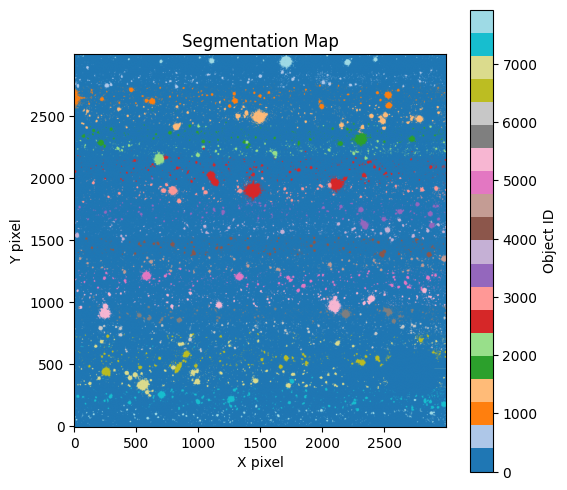

In [5]:
segmap_path = '/home/raditraian1107/PSF_development/FITS_images/se_in_out/segmap_cutout_251.0256_36.4566.fits'

seg_hdu = fits.open(segmap_path)
seg_data = seg_hdu[0].data
seg_hdu.close()

plt.figure(figsize=(6,6))
plt.imshow(seg_data, origin='lower', cmap='tab20') 
plt.colorbar(label='Object ID')
plt.title('Segmentation Map')
plt.xlabel('X pixel')
plt.ylabel('Y pixel')
plt.show()

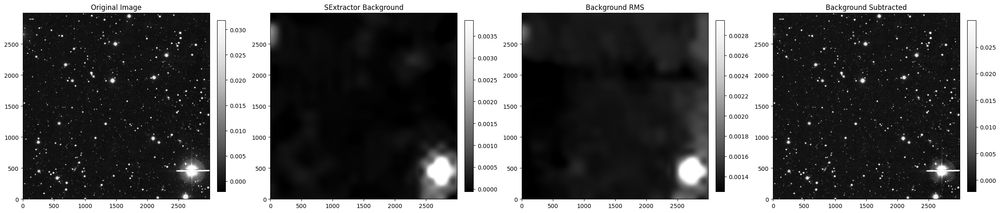

Background-subtracted image saved to: /home/raditraian1107/PSF_development/FITS_images/bkg_bySExtractor.fits


In [6]:
fits_path = '/home/raditraian1107/PSF_development/FITS_images/cutout_251.0256_36.4566.fits'
bkg_path = '/home/raditraian1107/PSF_development/FITS_images/se_in_out/bkg_cutout_251.0256_36.4566.fits'
bkg_rms_path = '/home/raditraian1107/PSF_development/FITS_images/se_in_out/bkg_rms_cutout_251.0256_36.4566.fits'

with fits.open(fits_path) as hdul_raw, \
     fits.open(bkg_path) as hdul_bkg, \
     fits.open(bkg_rms_path) as hdul_rms:

    raw_data = hdul_raw[0].data
    header = hdul_raw[0].header
    bkg_data = hdul_bkg[0].data
    bkg_rms_data = hdul_rms[0].data

subtracted_data = raw_data - bkg_data
vmin, vmax = np.percentile(raw_data, 5), np.percentile(raw_data, 99)

fig, axs = plt.subplots(1, 4, figsize=(24, 6), constrained_layout=True)

v0_min, v0_max = np.percentile(raw_data, 5), np.percentile(raw_data, 99)
im0 = axs[0].imshow(raw_data, origin='lower', cmap='Greys_r', vmin=v0_min, vmax=v0_max)
axs[0].set_title('Original Image')
plt.colorbar(im0, ax=axs[0], fraction=0.046, pad=0.04)

v1_min, v1_max = np.percentile(bkg_data, 5), np.percentile(bkg_data, 99)
im1 = axs[1].imshow(bkg_data, origin='lower', cmap='Greys_r', vmin=v1_min, vmax=v1_max)
axs[1].set_title('SExtractor Background')
plt.colorbar(im1, ax=axs[1], fraction=0.046, pad=0.04)

v2_min, v2_max = np.percentile(bkg_rms_data, 5), np.percentile(bkg_rms_data, 99)
im2 = axs[2].imshow(bkg_rms_data, origin='lower', cmap='Greys_r', vmin=v2_min, vmax=v2_max)
axs[2].set_title('Background RMS')
plt.colorbar(im2, ax=axs[2], fraction=0.046, pad=0.04)

v3_min, v3_max = np.percentile(subtracted_data, 5), np.percentile(subtracted_data, 99)
im3 = axs[3].imshow(subtracted_data, origin='lower', cmap='Greys_r', vmin=v3_min, vmax=v3_max)
axs[3].set_title('Background Subtracted')
plt.colorbar(im3, ax=axs[3], fraction=0.046, pad=0.04)
plt.show()

out_dir = '/home/raditraian1107/PSF_development/FITS_images'
os.makedirs(out_dir, exist_ok=True)
bkg_sub_path = os.path.join(out_dir, 'bkg_bySExtractor.fits')
fits.writeto(bkg_sub_path, subtracted_data.astype('float32'), header=header, overwrite=True)
print(f"Background-subtracted image saved to: {bkg_sub_path}")

Image shape: (3000, 3000)
Robust statistics of image:
Median: 0.00021881335123907775
Biweight mean: 0.0001706413039226933
MAD std: 0.0014829286925889774
Sigma-clipped stats: [0.00018236 0.00014005 0.00143257]
Mask radius (pixels): 18
Sigma-clipped stats (masked): [-3.21853780e-06 -7.43220289e-06  1.30757936e-03]
Global background value: 8.087850283718036e-05
Median 2D background: -1.64367865103093e-05
Median 2D RMS: 0.0013021047073028145


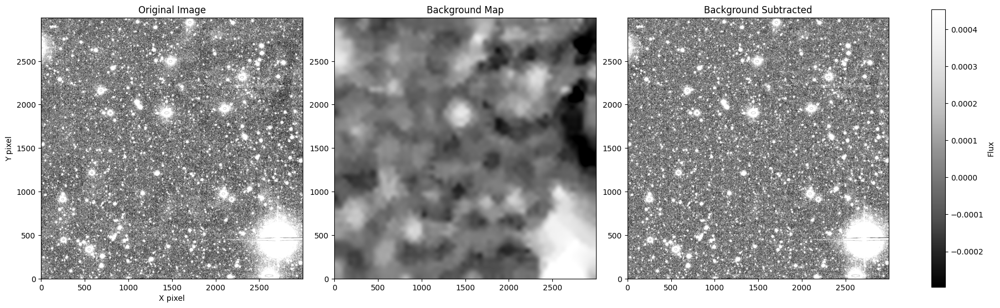

Background-subtracted image saved to: /home/raditraian1107/PSF_development/FITS_images/background_photutils.fits


In [7]:
fits_path = '/home/raditraian1107/PSF_development/FITS_images/cutout_251.0256_36.4566.fits'
out_path  = '/home/raditraian1107/PSF_development/FITS_images/background_photutils.fits'

sigma_clip = SigmaClip(sigma=3.0, maxiters=10)
box_size   = (50, 50)
filter_size= (3, 3)
exclude_percentile = 50.0
detect_npix = 10
detect_nsigma = 2.0

seeing_fwhm_arcsec = 1.5  
pixel_scale = 0.262        

with fits.open(fits_path) as hdul:
    data = hdul[0].data.astype(float)
    header = hdul[0].header

print("Image shape:", data.shape)
print("Robust statistics of image:")
print("Median:", np.median(data))
print("Biweight mean:", biweight_location(data))
print("MAD std:", mad_std(data))
mean, median, std = sigma_clipped_stats(data, sigma=3.0)
print("Sigma-clipped stats:", np.array([mean, median, std]))

threshold = detect_threshold(data, nsigma=detect_nsigma, sigma_clip=sigma_clip)
segment_img = detect_sources(data, threshold, npixels=detect_npix)
source_mask = segment_img.data > 0

fwhm_pix = seeing_fwhm_arcsec / pixel_scale
mask_radius = int(np.ceil(3.0 * fwhm_pix))
print("Mask radius (pixels):", mask_radius)

yy, xx = np.ogrid[-mask_radius:mask_radius+1, -mask_radius:mask_radius+1]
footprint = (xx**2 + yy**2) <= mask_radius**2
source_mask = binary_dilation(source_mask, structure=footprint)

mean, median, std = sigma_clipped_stats(data, sigma=3.0, mask=source_mask)
print("Sigma-clipped stats (masked):", np.array([mean, median, std]))

bkg_estimator = SExtractorBackground(sigma_clip=sigma_clip)
bkg_value = bkg_estimator(data)
print("Global background value:", bkg_value)

bkg_2d = Background2D(
    data, box_size=box_size, filter_size=filter_size,
    sigma_clip=sigma_clip, bkg_estimator=bkg_estimator,
    mask=source_mask, exclude_percentile=exclude_percentile
)

print("Median 2D background:", bkg_2d.background_median)
print("Median 2D RMS:", bkg_2d.background_rms_median)

data_bkgsub = data - bkg_2d.background

data_bkgsub = data - bkg_2d.background
vmin, vmax = np.percentile(bkg_2d.background, [1, 99])
fig, axes = plt.subplots(1, 3, figsize=(18, 6), constrained_layout=True)

im0 = axes[0].imshow(data, origin='lower', cmap='Greys_r', vmin=vmin, vmax=vmax)
axes[0].set_title("Original Image")
axes[0].set_xlabel("X pixel")
axes[0].set_ylabel("Y pixel")

im1 = axes[1].imshow(bkg_2d.background, origin='lower', cmap='Greys_r', vmin=vmin, vmax=vmax)
axes[1].set_title("Background Map")

im2 = axes[2].imshow(data_bkgsub, origin='lower', cmap='Greys_r', vmin=vmin, vmax=vmax)
axes[2].set_title("Background Subtracted")

cbar = fig.colorbar(im1, ax=axes, shrink=0.85)
cbar.set_label("Flux")
plt.show()

fits.writeto(out_path, data_bkgsub.astype('float32'), overwrite=True)
print(f"Background-subtracted image saved to: {out_path}")

Found 78 point sources
        X_IMAGE    Y_IMAGE  MAG_AUTO  CLASS_STAR
1      694.8932   152.0564   16.1375       1.000
6      341.7465    90.6664   18.1257       0.975
7     2615.0664    33.9213   11.9054       0.994
13    2167.3113    21.2470   15.4356       0.999
27    1002.1230     5.0107   16.8431       1.000
...         ...        ...       ...         ...
7356  1265.9105   226.8850   16.4559       1.000
7475  2977.8057   185.2377   16.8340       0.999
7920  1926.8737   152.9276   17.4458       0.997
7972  1108.3328  2954.5840   17.3137       0.983
7985  1706.0288  2947.9414   13.1409       0.997

[78 rows x 4 columns]


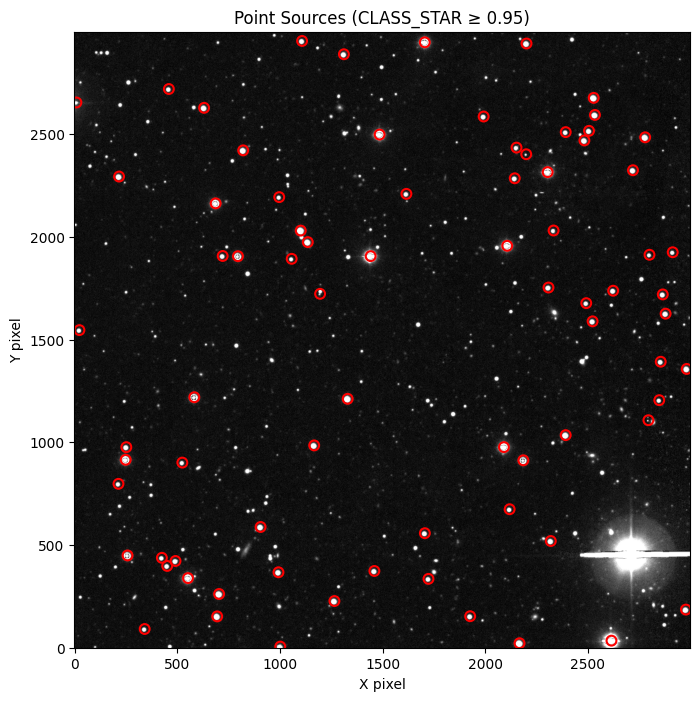

In [8]:
cat_file = f'{seoutpath}outparams_background_photutils.cat'
columns = []
with open(cat_file, 'r') as f:
    for line in f:
        if line.startswith('#'):
            parts = line.replace('#','').strip().split()
            if len(parts) >= 2:
                columns.append(parts[1])
        else:
            break

catalog = pd.read_csv(cat_file, comment='#', sep=r'\s+', names=columns)

point_sources = catalog[
    (catalog['CLASS_STAR'] >= 0.95)
    ]


print(f"Found {len(point_sources)} point sources")
print(point_sources[['X_IMAGE', 'Y_IMAGE', 'MAG_AUTO', 'CLASS_STAR']])

fits_file = f'/home/raditraian1107/PSF_development/FITS_images/background_photutils.fits'
with fits.open(fits_file) as hdul:
    img_data = hdul[0].data

plt.figure(figsize=(8,8))
plt.imshow(data, origin='lower', cmap='gray',
vmin=np.percentile(data, 5),
vmax=np.percentile(data, 99))

plt.scatter(point_sources['X_IMAGE'], point_sources['Y_IMAGE'],
s=50, edgecolor='red', facecolors='none', linewidths=1.5, marker='o')

plt.title(f'Point Sources (CLASS_STAR ≥ 0.95)')
plt.xlabel('X pixel')
plt.ylabel('Y pixel')
plt.show()

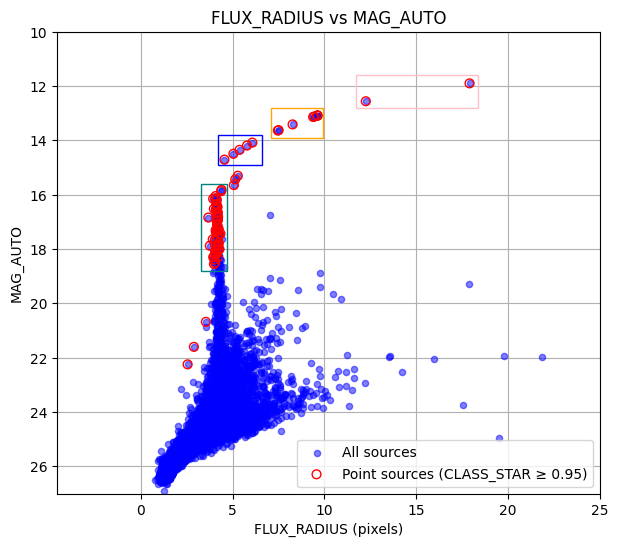

In [9]:
columns = []
with open(cat_file, 'r') as f:
    for line in f:
        if line.startswith('#'):
            parts = line.replace('#','').strip().split()
            if len(parts) >= 2:
                columns.append(parts[1])
        else:
            break
catalog = pd.read_csv(cat_file, comment='#', sep=r'\s+', names=columns)

point_sources = catalog[catalog['CLASS_STAR'] >= 0.95]
fig, ax = plt.subplots(figsize=(7,6))

ax.scatter(catalog['FLUX_RADIUS'], catalog['MAG_AUTO'], s=20, color='blue', alpha=0.5, label='All sources')
ax.scatter(point_sources['FLUX_RADIUS'], point_sources['MAG_AUTO'], s=40,
           edgecolor='red', facecolors='none', label='Point sources (CLASS_STAR ≥ 0.95)')

rects = [
    ((3.3, 15.6), 1.4, 3.2, 'teal'),
    ((4.2, 13.8), 2.4, 1.1, 'blue'),
    ((7.1, 12.8), 2.8, 1.1, 'orange'),
    ((11.7, 11.6), 6.7, 1.2, 'pink')
]
for (x,y), w, h, color in rects:
    ax.add_patch(patches.Rectangle((x,y), w, h, linewidth=1, edgecolor=color, facecolor='none'))

ax.set_xlim(right=25)
ax.set_ylim(27, 10)
ax.set_xlabel('FLUX_RADIUS (pixels)')
ax.set_ylabel('MAG_AUTO')
ax.set_title('FLUX_RADIUS vs MAG_AUTO')
ax.legend()
ax.grid(True)
ax.set_axisbelow(True)
plt.show()

Image shape: 3000 x 3000
Cutout counts by patch: {'patch_1': 57, 'patch_2': 5, 'patch_3': 8, 'patch_4': 2}
Total saved cutouts: 72


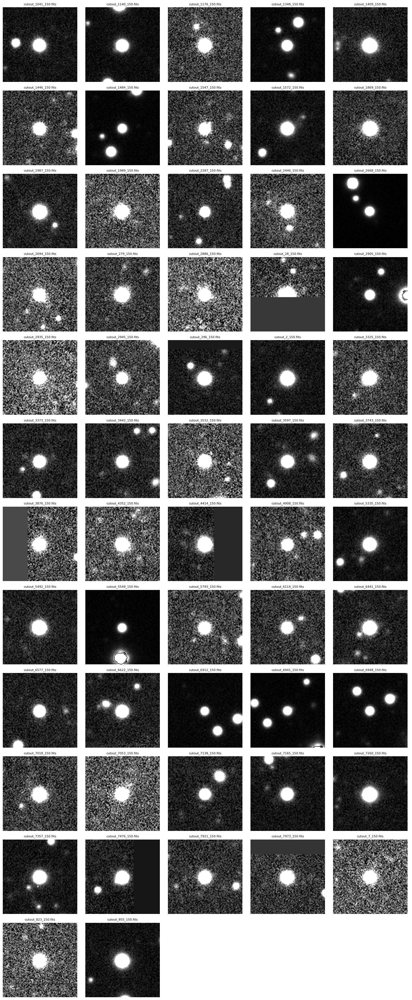

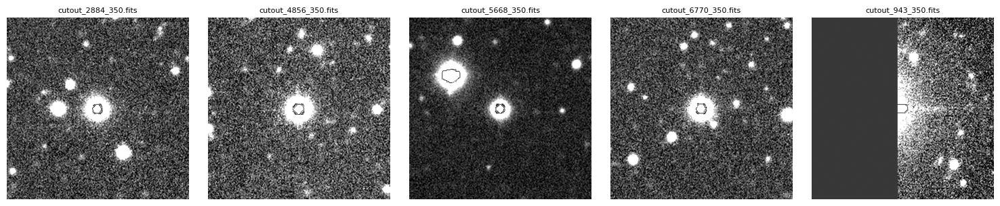

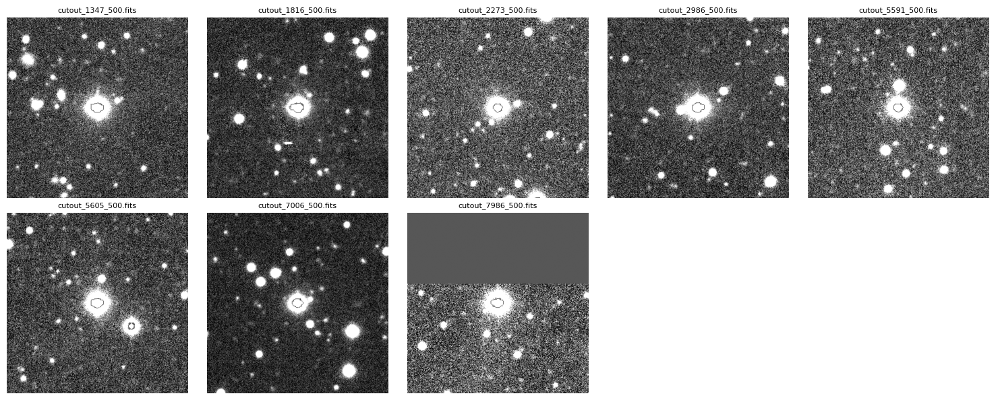

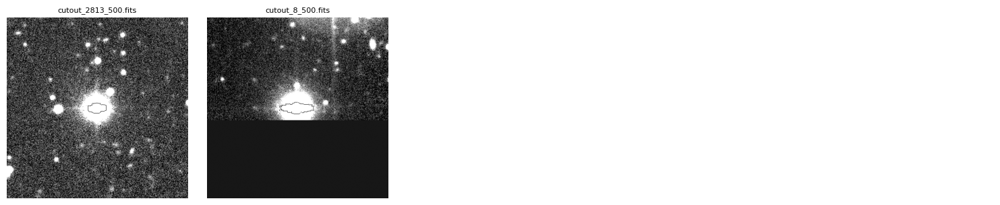

In [10]:
fits_file = '/home/raditraian1107/PSF_development/FITS_images/background_photutils.fits'
cat_path  = '/home/raditraian1107/PSF_development/FITS_images/se_in_out/outparams_background_photutils.cat'

PATCHES = [
    (3.3, 4.7, 15.6, 18.8, 150, 'patch_1'),
    (4.2, 6.4, 13.8, 14.9, 350, 'patch_2'),
    (7.1, 9.9, 12.8, 13.9, 500, 'patch_3'),
    (11.7, 18.4, 11.6, 12.8, 500, 'patch_4')
]

for _, _, _, _, _, folder in PATCHES:
    cutouts_dir = os.path.join(folder, 'cutouts')
    os.makedirs(cutouts_dir, exist_ok=True)

def get_patch(flux_radius, mag):
    for fr_min, fr_max, m_min, m_max, size, folder in PATCHES:
        if fr_min <= flux_radius <= fr_max and m_min <= mag <= m_max:
            return size, os.path.join(folder, 'cutouts')
    return None, None

with fits.open(fits_path) as h:
    img = h[0].data

ny, nx = img.shape
print(f'Image shape: {nx} x {ny}')


cat = pd.read_csv(cat_path, comment='#', sep=r'\s+', header=None)
cat.columns = [
    'NUMBER',        # 1
    'FLUX_AUTO',     # 2
    'FLUXERR_AUTO',  # 3
    'MAG_AUTO',      # 4
    'MAGERR_AUTO',   # 5
    'THRESHOLD',     # 6
    'X_IMAGE',       # 7
    'Y_IMAGE',       # 8
    'FLAGS',         # 9
    'FWHM_IMAGE',    # 10
    'FWHM_WORLD',    # 11
    'CLASS_STAR',    # 12
    'FLUX_RADIUS'    # 13
]

patch_counts = {folder: 0 for _, _, _, _, _, folder in PATCHES}

for _, row in cat.iterrows():
    if row['CLASS_STAR'] <= 0.95:
        continue
    _, folder_path = get_patch(row['FLUX_RADIUS'], row['MAG_AUTO'])
    if folder_path:
        patch_counts[os.path.basename(os.path.dirname(folder_path))] += 1

print('Cutout counts by patch:', patch_counts)

saved_files = 0

for _, row in cat.iterrows():
    if row['CLASS_STAR'] <= 0.95:
        continue

    size, folder_path = get_patch(row['FLUX_RADIUS'], row['MAG_AUTO'])
    if size is None:
        continue

    x, y = row['X_IMAGE'], row['Y_IMAGE']
    cut = Cutout2D(img, (x, y), (size, size), mode='partial', fill_value=0)
    
    out_name = os.path.join(folder_path, f'cutout_{int(row["NUMBER"])}_{size}.fits')
    fits.writeto(out_name, cut.data.astype('float32'), overwrite=True)
    saved_files += 1

print(f'Total saved cutouts: {saved_files}')

for _, _, _, _, _, folder in PATCHES:
    cutouts_dir = os.path.join(folder, 'cutouts')
    cutout_files = sorted([f for f in os.listdir(cutouts_dir) if f.endswith('.fits')])
    if not cutout_files:
        continue

    n_cols = 5
    n_rows = int(np.ceil(len(cutout_files) / n_cols))
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 3*n_rows))
    axes = axes.flatten()

    for ax, fname in zip(axes, cutout_files):
        path = os.path.join(cutouts_dir, fname)
        data = fits.getdata(path)
        vmin, vmax = np.percentile(data, 3), np.percentile(data, 97)
        ax.imshow(data, origin='lower', cmap='gray', vmin=vmin, vmax=vmax)
        ax.set_title(fname, fontsize=8)
        ax.axis('off')

    for ax in axes[len(cutout_files):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

/tmp/ipykernel_15047/4048786470.py:96: RuntimeWarning: invalid value encountered in log10
  axes[i, 0].imshow(np.log10(cutout + 1e-3), cmap='gray', origin='lower',
/tmp/ipykernel_15047/4048786470.py:115: RuntimeWarning: invalid value encountered in log10
  axes[i, 4].imshow(np.log10(multiplied + 1e-3), cmap='gray', origin='lower',


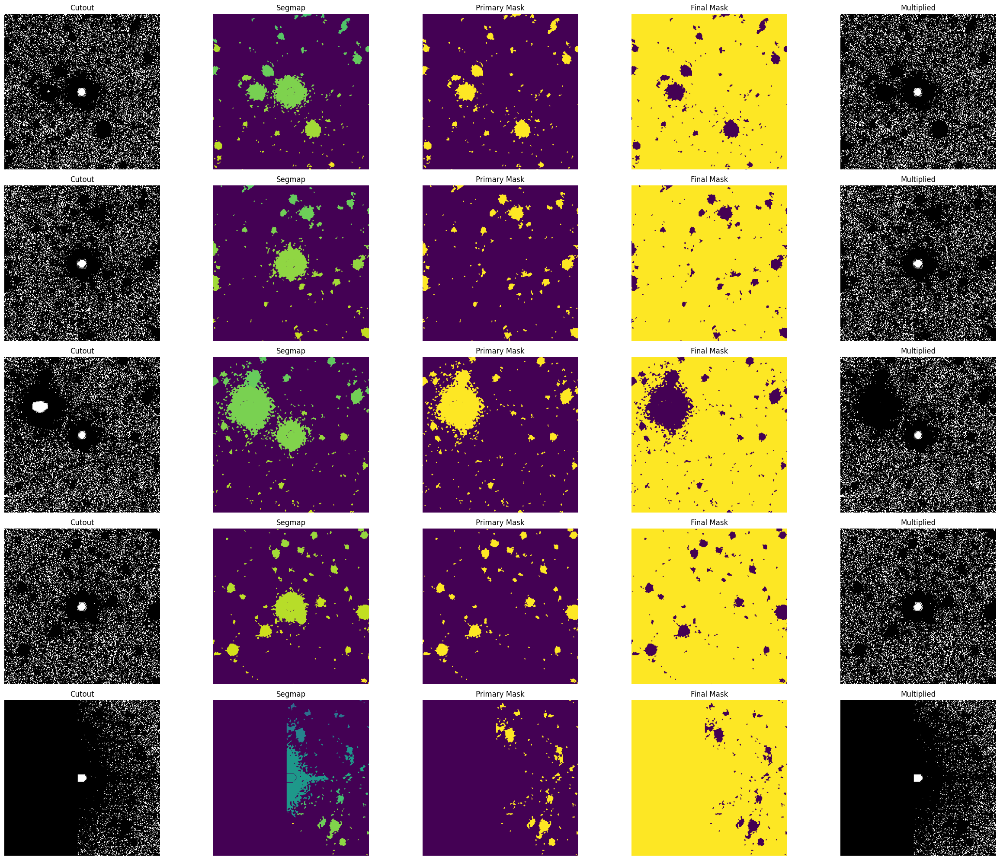

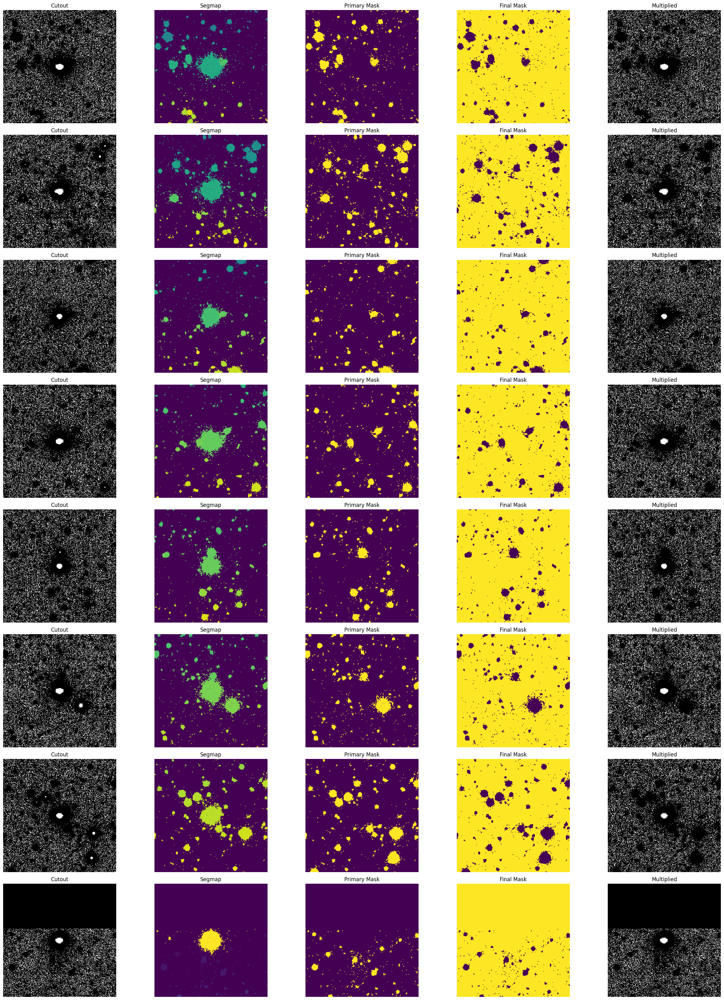

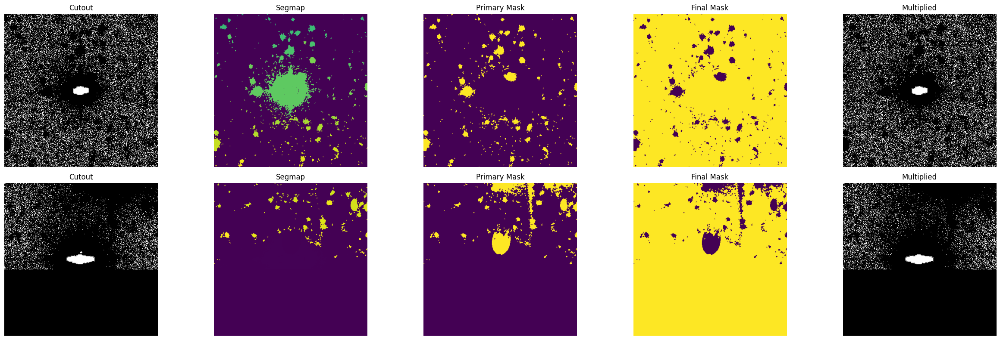

In [11]:
fits_file = '/home/raditraian1107/PSF_development/FITS_images/background_photutils.fits'
cat_path  = '/home/raditraian1107/PSF_development/FITS_images/se_in_out/outparams_background_photutils.cat'
seg_path  = '/home/raditraian1107/PSF_development/FITS_images/se_in_out/segmap_cutout_251.0256_36.4566.fits'

PATCHES = [
    (3.3, 4.7, 15.6, 19, 150, 'patch_1'),
    (4.2, 6.4, 13.8, 14.9, 350, 'patch_2'),
    (7.1, 9.9, 12.8, 13.9, 500, 'patch_3'),
    (11.7, 18.4, 11.6, 12.8, 500, 'patch_4')
]

cat = pd.read_csv(cat_path, comment='#', sep=r'\s+', header=None)
cat.columns = [
    'NUMBER', 'FLUX_AUTO', 'FLUXERR_AUTO', 'MAG_AUTO', 'MAGERR_AUTO',
    'THRESHOLD', 'X_IMAGE', 'Y_IMAGE', 'FLAGS', 'FWHM_IMAGE',
    'FWHM_WORLD', 'CLASS_STAR', 'FLUX_RADIUS'
]


with fits.open(fits_file) as h:
    img = h[0].data

seg = fits.getdata(seg_path)
for _, _, _, _, _, folder in PATCHES:
    for sub in ['cutouts', 'segmaps', 'primary_masking', 'final_masking', 'multiplied']:
        os.makedirs(os.path.join(folder, sub), exist_ok=True)

def get_patch(flux_radius, mag):
    for fr_min, fr_max, m_min, m_max, size, folder in PATCHES:
        if fr_min <= flux_radius <= fr_max and m_min <= mag <= m_max:
            return size, folder
    return None, None

for _, row in cat.iterrows():
    if row['CLASS_STAR'] <= 0.95:
        continue

    size, folder = get_patch(row['FLUX_RADIUS'], row['MAG_AUTO'])
    if size is None:
        continue

    x, y = row['X_IMAGE'], row['Y_IMAGE']

    cutout_obj = Cutout2D(img, (x, y), (size, size), mode='partial', fill_value=0)
    cutout_data = cutout_obj.data
    cut_name = f'cutout_{int(row["NUMBER"])}_{size}.fits'
    fits.writeto(os.path.join(folder, 'cutouts', cut_name),
                 cutout_data.astype('float32'), overwrite=True)

    seg_cut = Cutout2D(seg, (x, y), (size, size), mode='partial', fill_value=0)
    seg_name = f'segmap_{cut_name}'
    fits.writeto(os.path.join(folder, 'segmaps', seg_name),
                 seg_cut.data.astype('int32'), overwrite=True)

    ny, nx = seg_cut.data.shape
    cy, cx = ny // 2, nx // 2
    target_id = seg_cut.data[cy, cx]

    primary_mask = seg_cut.data.copy()
    primary_mask[primary_mask == target_id] = 0  
    primary_mask[primary_mask != 0] = 1          
    fits.writeto(os.path.join(folder, 'primary_masking', cut_name),
                 primary_mask.astype('int32'), overwrite=True)

    final_mask = np.ones_like(seg_cut.data, dtype='float32')
    final_mask[primary_mask == 1] = 0   
    fits.writeto(os.path.join(folder, 'final_masking', cut_name),
                 final_mask, overwrite=True)

    multiplied = cutout_data * final_mask
    fits.writeto(os.path.join(folder, 'multiplied', cut_name),
                 multiplied.astype('float32'), overwrite=True)

for _, _, _, _, _, folder in PATCHES:
    cutouts_dir = os.path.join(folder, 'cutouts')
    segmaps_dir = os.path.join(folder, 'segmaps')
    primary_dir = os.path.join(folder, 'primary_masking')
    final_dir   = os.path.join(folder, 'final_masking')
    multiplied_dir = os.path.join(folder, 'multiplied')

    cutout_files = sorted([f for f in os.listdir(cutouts_dir) if f.endswith('.fits')])
    if not cutout_files:
        continue

    n_files = len(cutout_files)
    fig, axes = plt.subplots(n_files, 5, figsize=(25, 4 * n_files))
    axes = np.atleast_2d(axes)

    for i, fname in enumerate(cutout_files):
        cutout = fits.getdata(os.path.join(cutouts_dir, fname))
        segmap = fits.getdata(os.path.join(segmaps_dir, f'segmap_{fname}'))
        primary_mask = fits.getdata(os.path.join(primary_dir, fname))
        final_mask = fits.getdata(os.path.join(final_dir, fname))
        multiplied = fits.getdata(os.path.join(multiplied_dir, fname))

        axes[i, 0].imshow(np.log10(cutout + 1e-3), cmap='gray', origin='lower',
                          vmin=np.percentile(cutout, 5), vmax=np.percentile(cutout, 95))
        axes[i, 0].set_title('Cutout')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(segmap, cmap='viridis', origin='lower')
        axes[i, 1].set_title('Segmap')
        axes[i, 1].axis('off')

        axes[i, 2].imshow(primary_mask, cmap='viridis', origin='lower')
        axes[i, 2].set_title('Primary Mask')
        axes[i, 2].axis('off')

        cmap_mask = plt.cm.viridis.copy()
        cmap_mask.set_bad(color='black')
        axes[i, 3].imshow(final_mask, cmap=cmap_mask, origin='lower', vmin=0, vmax=1)
        axes[i, 3].set_title('Final Mask')
        axes[i, 3].axis('off')

        axes[i, 4].imshow(np.log10(multiplied + 1e-3), cmap='gray', origin='lower',
                          vmin=np.percentile(multiplied, 5), vmax=np.percentile(multiplied, 95))
        axes[i, 4].set_title('Multiplied')
        axes[i, 4].axis('off')

    plt.tight_layout()
    plt.show()


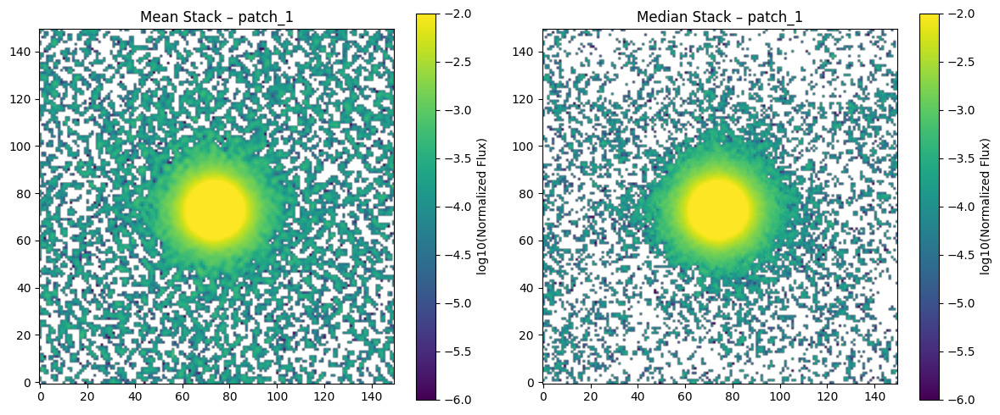

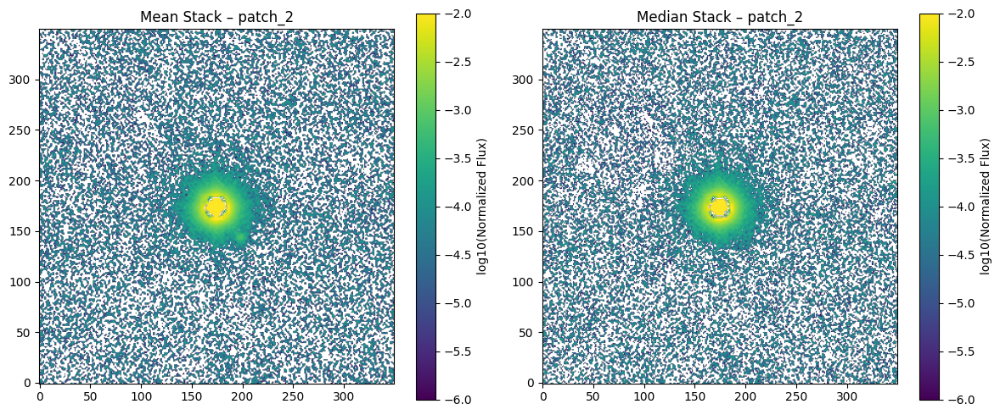

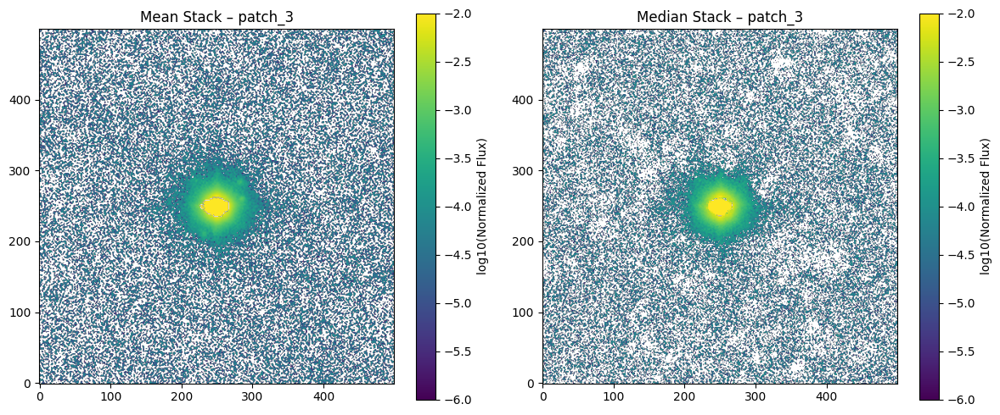

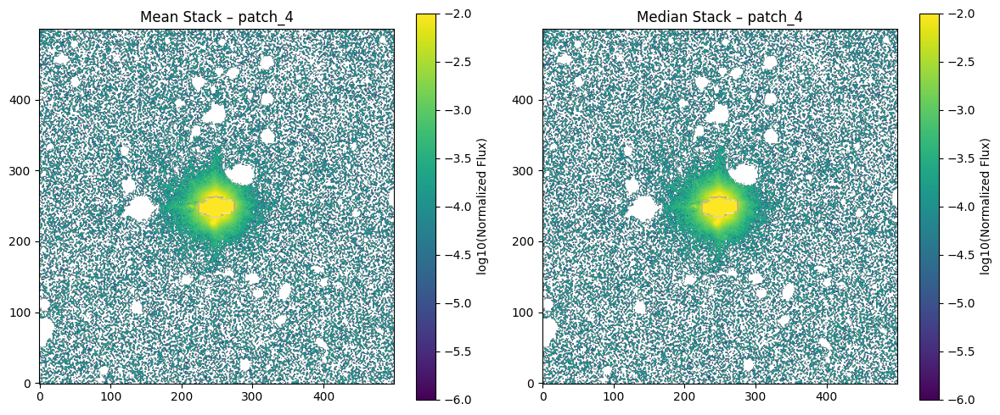

In [12]:
VMIN = -6
VMAX = -2
MIN_VALID_FRACTION = 0.4

STACK_GROUPS = {
    'patch_1': ['patch_1'],
    'patch_2': ['patch_2'],
    'patch_3': ['patch_3'],
    'patch_4': ['patch_4'],
}

for stack_name, patch_list in STACK_GROUPS.items():

    stacked_dir = os.path.join(stack_name, 'stacked')
    os.makedirs(stacked_dir, exist_ok=True)

    stack_list = []

    for patch in patch_list:
        multiplied_dir = os.path.join(patch, 'multiplied')

        if not os.path.isdir(multiplied_dir):
            print(f"Missing directory: {multiplied_dir}")
            continue

        multiplied_files = sorted(
            [f for f in os.listdir(multiplied_dir) if f.endswith('.fits')]
        )

        for fname in multiplied_files:
            fpath = os.path.join(multiplied_dir, fname)
            data = fits.getdata(fpath)

            valid_mask = np.isfinite(data) & (data > 0)
            valid_fraction = np.sum(valid_mask) / data.size

            if valid_fraction < MIN_VALID_FRACTION:
                continue

            ny, nx = data.shape
            radius = min(nx, ny) // 2

            # Normalize using the center
            center_val = np.nanmax(
                data[
                    ny//2 - radius//10 : ny//2 + radius//10,
                    nx//2 - radius//10 : nx//2 + radius//10
                ]
            )

            if not (np.isfinite(center_val) and center_val > 0):
                continue

            stack_list.append(data / center_val)

    if len(stack_list) == 0:
        print(f"No valid PSFs for stack {stack_name}")
        continue

    stack_array = np.array(stack_list)

    mean_stack   = np.nanmean(stack_array, axis=0)
    median_stack = np.nanmedian(stack_array, axis=0)

    fits.writeto(
        os.path.join(stacked_dir, f'mean_psf_{stack_name}.fits'),
        mean_stack.astype('float32'),
        overwrite=True
    )

    fits.writeto(
        os.path.join(stacked_dir, f'median_psf_{stack_name}.fits'),
        median_stack.astype('float32'),
        overwrite=True
    )

    # Safe log10 for plotting
    def log_image(img):
        out = img.copy()
        out[out <= 0] = np.nan
        return np.log10(out)

    mean_plot   = log_image(mean_stack)
    median_plot = log_image(median_stack)

    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    im0 = axes[0].imshow(mean_plot, origin='lower', cmap='viridis', vmin=VMIN, vmax=VMAX)
    axes[0].set_title(f'Mean Stack – {stack_name}')
    plt.colorbar(im0, ax=axes[0], label='log10(Normalized Flux)')

    im1 = axes[1].imshow(median_plot, origin='lower', cmap='viridis', vmin=VMIN, vmax=VMAX)
    axes[1].set_title(f'Median Stack – {stack_name}')
    plt.colorbar(im1, ax=axes[1], label='log10(Normalized Flux)')

    plt.tight_layout()
    plt.show()

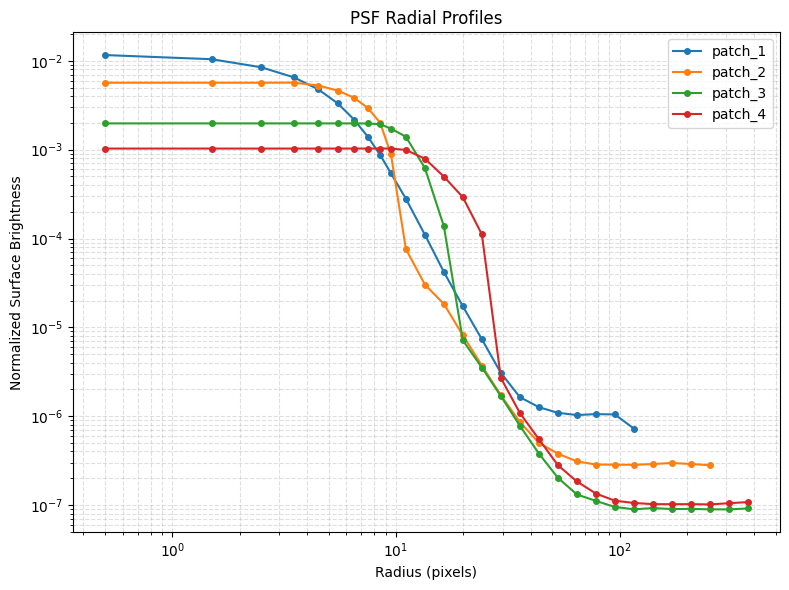

In [13]:
STACKS = {
    'patch_1':  'patch_1/stacked/median_psf_patch_1.fits',
    'patch_2':  'patch_2/stacked/median_psf_patch_2.fits',
    'patch_3': 'patch_3/stacked/median_psf_patch_3.fits',
    'patch_4': 'patch_4/stacked/median_psf_patch_4.fits',
}

radial_profiles = {}

radii_linear = np.arange(0, 11, 1)

radii_log = np.logspace(np.log10(10), np.log10(500), 21)
radii = np.concatenate([radii_linear, radii_log[1:]])


for name, fpath in STACKS.items():
    psf = fits.getdata(fpath)

    mask_invalid = ~np.isfinite(psf) | (psf <= 0)

    total_flux = np.nansum(psf[~mask_invalid])
    psf_norm = np.zeros_like(psf)
    psf_norm[~mask_invalid] = psf[~mask_invalid] / total_flux

    ny, nx = psf_norm.shape
    xycen = (nx / 2, ny / 2)

    rp = RadialProfile(psf_norm, xycen, radii, mask=mask_invalid)
    radial_profiles[name] = {
        'r': rp.radius,
        'profile': rp.profile
    }

plt.figure(figsize=(8,6))
for name, data in radial_profiles.items():
    plt.plot(
        data['r'],
        data['profile'],
        marker='o',
        markersize=4,
        linewidth=1.5,
        label=name
    )

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Radius (pixels)')
plt.ylabel('Normalized Surface Brightness')
plt.title('PSF Radial Profiles')
plt.grid(True, which='both', ls='--', alpha=0.4)
plt.legend()
plt.tight_layout()
plt.show()